# Importing Libraries

In [586]:
# Data Manipulation Libraries
import numpy as np       # numpy for numerical python
import pandas as pd       # pandas for data manipulation
from pandas.plotting import table  
import datetime as dt          # importing datetime to deal with the date and time formats
from datetime import datetime,timedelta,date
from scipy import stats    # importing stats for outlier removal
import matplotlib.pyplot as plt      # Visualisation Libraries
from matplotlib import ticker
import seaborn as sns
plt.style.use('fivethirtyeight')
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
from itertools import cycle
from sklearn.preprocessing import MinMaxScaler  
from sklearn.metrics import mean_absolute_error, mean_squared_error
# Deep Learning  
import tensorflow as tf
import keras
from keras.models import Sequential  
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Dropout, Activation,Embedding,Flatten,TimeDistributed
from keras.layers import Dense
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import LSTM, GRU
from keras.layers import Conv1D,MaxPooling1D,Flatten
from keras.layers import BatchNormalization
from keras.layers import SimpleRNN
from keras.layers import Input, Conv1D, MaxPooling1D, Dense, Flatten, concatenate, LeakyReLU, Activation
from keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau
from keras.models import Model
from keras import backend as K
from tensorflow.keras.optimizers import RMSprop, Adam
import warnings
warnings.filterwarnings('ignore')

# Loading Raw Data File

In [588]:
df = pd.read_csv('AAPL.csv')                   # reading data from raw csv file

In [590]:
df.head()              # getting first 5 rows of data

,Date,Open,High,Low,Close,Adj Close,Volume
0,1980-12-12,0.128348,0.128906,0.128348,0.128348,0.099058,469033600
1,1980-12-15,0.122210,0.122210,0.121652,0.121652,0.093890,175884800
2,1980-12-16,0.113281,0.113281,0.112723,0.112723,0.086999,105728000
3,1980-12-17,0.115513,0.116071,0.115513,0.115513,0.089152,86441600
4,1980-12-18,0.118862,0.119420,0.118862,0.118862,0.091737,73449600


In [591]:
df.tail()                              # getting last 5 rows of data

,Date,Open,High,Low,Close,Adj Close,Volume
10996,2024-07-29,216.960007,219.300003,215.750000,218.240005,218.240005,36311800
10997,2024-07-30,219.190002,220.330002,216.119995,218.800003,218.800003,41643800
10998,2024-07-31,221.440002,223.820007,220.630005,222.080002,222.080002,50036300
10999,2024-08-01,224.369995,224.479996,217.020004,218.360001,218.360001,62501000
11000,2024-08-02,219.149994,225.600006,217.710007,219.860001,219.860001,98480100


In [592]:
df.shape                     # getting the shape of the data

(11001, 7)

In [593]:
df.describe()               # data statistical description

,Open,High,Low,Close,Adj Close,Volume
count,11001.000000,11001.000000,11001.000000,11001.000000,11001.000000,1.100100e+04
mean,22.353524,22.594167,22.121922,22.366691,21.573529,3.180131e+08
std,46.115061,46.609303,45.650045,46.147100,45.726160,3.354317e+08
min,0.049665,0.049665,0.049107,0.049107,0.037900,0.000000e+00
25%,0.299107,0.304129,0.290179,0.298549,0.242342,1.132240e+08
50%,0.531250,0.537946,0.522321,0.531250,0.432579,2.056880e+08
75%,20.256071,20.424286,20.026072,20.225714,17.279541,3.984876e+08
max,236.479996,237.229996,233.089996,234.820007,234.820007,7.421641e+09


In [595]:
df.info()                      # gettting info of data types of columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11001 entries, 0 to 11000
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Date       11001 non-null  object 
 1   Open       11001 non-null  float64
 2   High       11001 non-null  float64
 3   Low        11001 non-null  float64
 4   Close      11001 non-null  float64
 5   Adj Close  11001 non-null  float64
 6   Volume     11001 non-null  int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 601.7+ KB


# Data Preprocessing

In [602]:
#Checking null values row and column wise
def check_null_values(data: pd.DataFrame):
    # Printing the total number of null values per column
    print("Null values:")
    print(data.isnull().sum())
    
    # Printing rows with any null values
    print("\nRows having null values:")
    print(data[data.isnull().any(axis=1)])


check_null_values(df)

Null values:
Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

Rows having null values:
Empty DataFrame
Columns: [Date, Open, High, Low, Close, Adj Close, Volume]
Index: []


In [11]:
# Extracting the summary about data
def summarize_data(data: pd.DataFrame):
    # Printing the total number of days (rows) and attributes (columns)
    print("Total number of days accounted: ", data.shape[0])
    print("Total number of attributes: ", data.shape[1])
    
    # Printing the total number of null values and check for any NA values
    print("Null values in data:", data.isnull().values.sum())
    print("NA values in data:", data.isna().values.any())
    
    # Converting the 'Date' column to DateTime object
    if 'Date' in data.columns:
        data['Date'] = pd.to_datetime(data['Date'])
        # Sort data by 'Date'
        data = data.sort_values(by='Date')
        # Print the first and last date in the DataFrame
        print("First date: ", data['Date'].iloc[0])
        print("Last date: ", data['Date'].iloc[-1])
    else:
        print("No 'Date' column found in the DataFrame.")

summarize_data(df)

Total number of days accounted:  11001
Total number of attributes:  7
Null values in data: 0
NA values in data: False
First date:  1980-12-12 00:00:00
Last date:  2024-08-02 00:00:00


# Exploratory Data Analysis

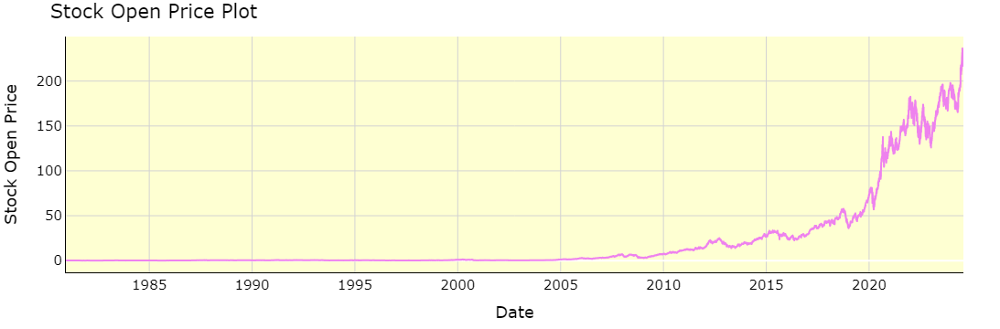

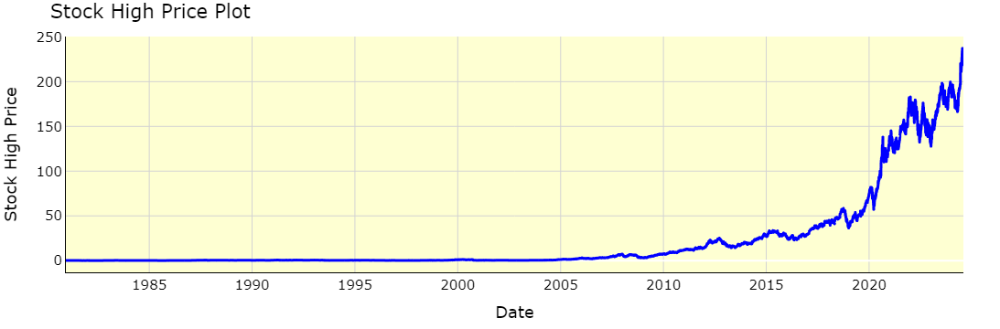

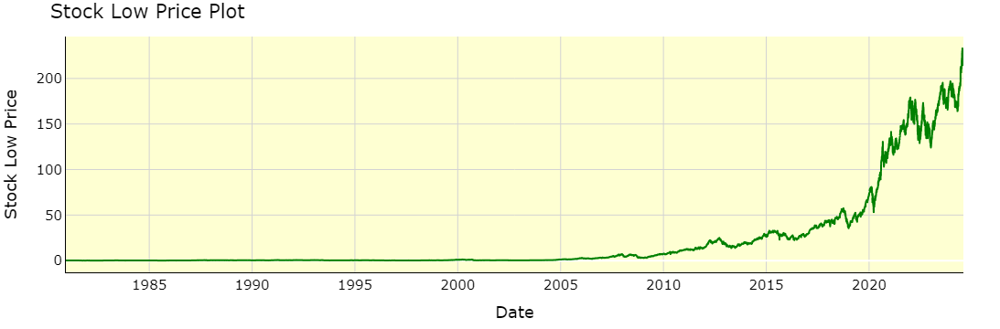

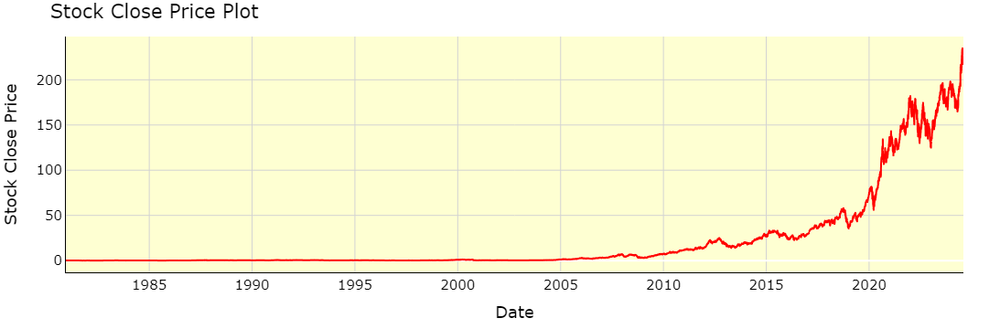

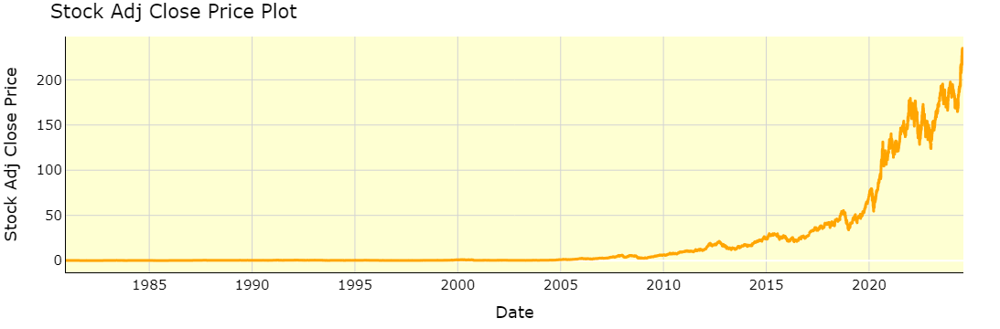

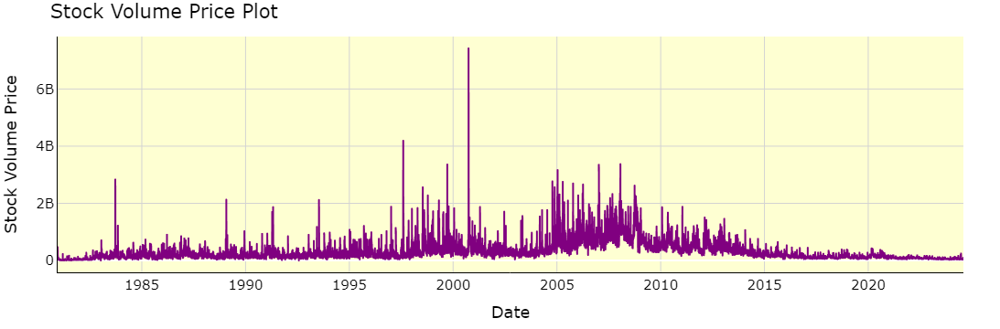

In [605]:
# Plotting the data trend of stock prices like 'Open', 'High', 'Low', 'Close' using line plot
# List of columns to plot
Column_List = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']

colors = ['violet', 'blue', 'green', 'red', 'orange', 'purple']
line_sizes = [2, 3, 2, 2, 3, 2]  # Customizable line sizes
bg_color = '#FEFFD2'  # Customizable background color
border_color = 'black'  # Customizable border color

# Creating separate plots for each column
for i, column in enumerate(Column_List):
    # Creating a line plot for the column
    fig = px.line(df, x=df['Date'], y=df[column],
                  labels={'Date': 'Date', column: f'Stock {column} Price'},
                  line_shape='linear')  
    
    # Updating line properties
    fig.update_traces(line=dict(color=colors[i], width=line_sizes[i]))
    
    # Updating the layout for the current plot
    fig.update_layout(
        title_text=f'Stock {column} Price Plot',
        plot_bgcolor=bg_color,  
        paper_bgcolor='white',  
        font_size=15,
        font_color='black',
        xaxis_title='Date',
        yaxis_title=f'Stock {column} Price',
        margin=dict(l=40, r=40, t=40, b=40),  
        showlegend=True
    )
    
    fig.update_xaxes(
        showgrid=True,
        gridcolor='LightGray',
        showline=True,
        linecolor=border_color,
        linewidth=1
    )
    
    fig.update_yaxes(
        showgrid=True,
        gridcolor='LightGray',
        showline=True,
        linecolor=border_color,
        linewidth=1
    )
    
    # Showing the figure
    fig.show()


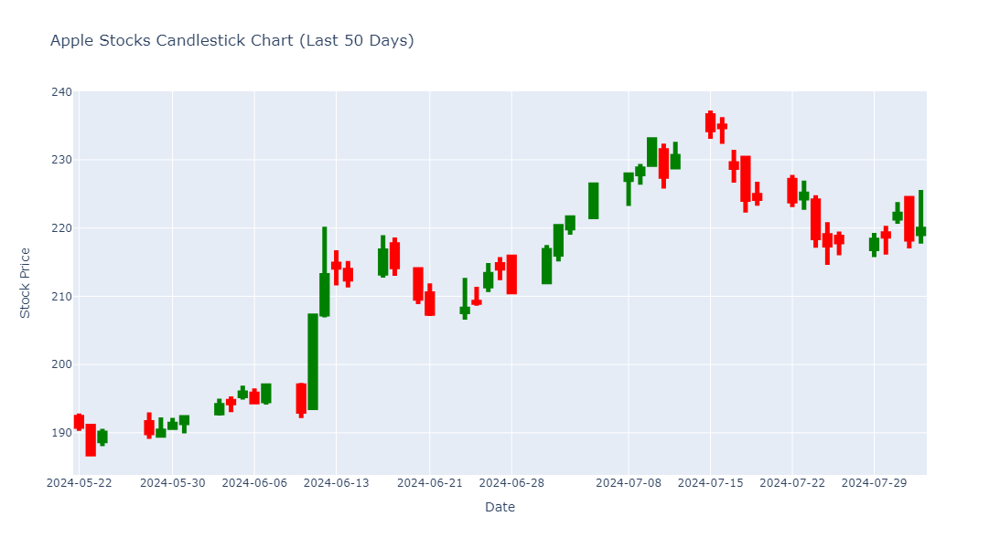

In [613]:
# Plotting candelstick plot for Open, High, Low and Close prices
df_candlestick = df[['Date', 'Open', 'High', 'Low', 'Close', 'Volume']].tail(50)

# Ensuring the 'Date' column is in datetime format
df_candlestick['Date'] = pd.to_datetime(df_candlestick['Date'])

# Creating the candlestick chart
fig = go.Figure(data=[go.Candlestick(x=df_candlestick['Date'],
                                     open=df_candlestick['Open'],
                                     high=df_candlestick['High'],
                                     low=df_candlestick['Low'],
                                     close=df_candlestick['Close'],
                                     increasing_line_color='green',
                                     decreasing_line_color='red',
                                     increasing_fillcolor='green',
                                     decreasing_fillcolor='red',
                                     line=dict(width=5))])

# Customizing the layout
fig.update_layout(
    title='Apple Stocks Candlestick Chart (Last 50 Days)',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    #template='plotly_dark',
    width=1000,
    height=600,
    xaxis_rangeslider_visible=False,  
    xaxis=dict(
        tickmode='array',
        tickvals=df_candlestick['Date'][::5],  # Setting tick values at 5-day intervals
        ticktext=[date.strftime('%Y-%m-%d') for date in df_candlestick['Date'][::5]] 
    )
)

fig.show()


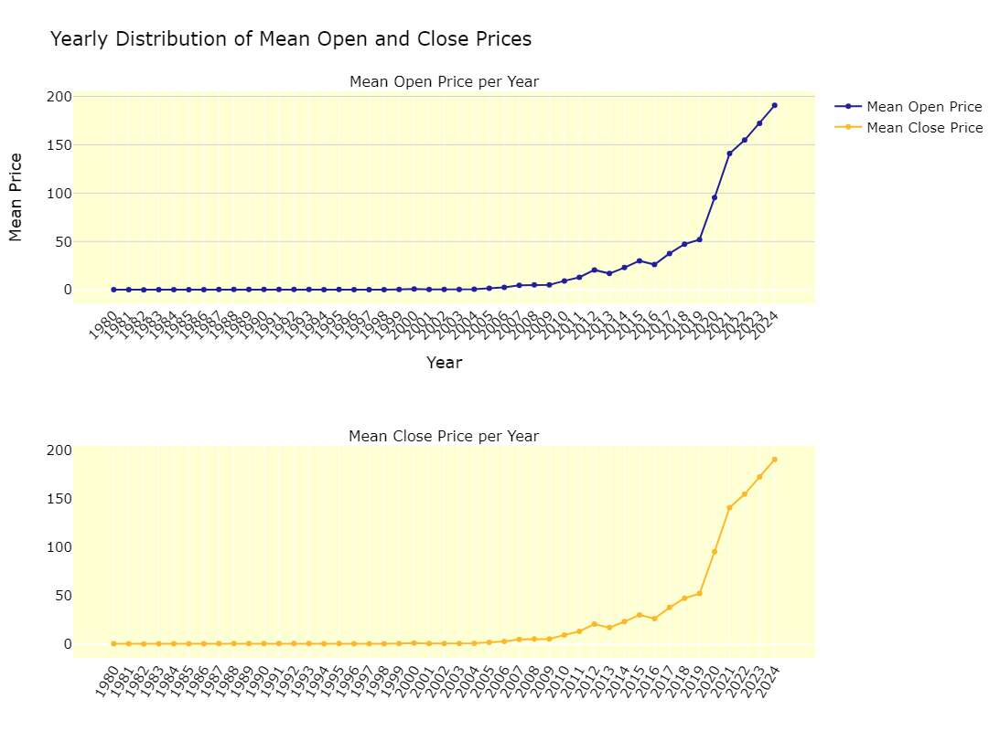

In [615]:
# Plotting Yearly Distribution of Mean Open and Close Prices
# Converting 'Date' to datetime
df['Date'] = pd.to_datetime(df['Date'])

# Extract year from 'Date'
df['Year'] = df['Date'].dt.year

# Calculating mean open and close prices per year
yearly_mean = df.groupby('Year').agg({
    'Open': 'mean',
    'Close': 'mean'
}).reset_index()

# Creating subplots
fig = make_subplots(
    rows=2, cols=1,
    subplot_titles=('Mean Open Price per Year', 'Mean Close Price per Year')
)

# Adding line plot for mean open prices
fig.add_trace(go.Scatter(
    x=yearly_mean['Year'],
    y=yearly_mean['Open'],
    mode='lines+markers',
    name='Mean Open Price',
    line=dict(color='#21209C'),
    marker=dict(color='#21209C')
), row=1, col=1)

# Adding line plot for mean close prices
fig.add_trace(go.Scatter(
    x=yearly_mean['Year'],
    y=yearly_mean['Close'],
    mode='lines+markers',
    name='Mean Close Price',
    line=dict(color='#FDB827'),
    marker=dict(color='#FDB827')
), row=2, col=1)

# Update layout
fig.update_layout(
    title='Yearly Distribution of Mean Open and Close Prices',
    xaxis_title='Year',
    yaxis_title='Mean Price',
    plot_bgcolor='#FEFFD2',
    font_size=15,
    font_color='black',
    width=1100,  # Set plot width
    height=800,  # Set plot height
    showlegend=True
)

fig.update_xaxes(
    tickmode='array',
    tickvals=yearly_mean['Year'],
    ticktext=[str(year) for year in yearly_mean['Year']],
    tickangle=-45,
    row=1, col=1
)

fig.update_xaxes(
    tickmode='array',
    tickvals=yearly_mean['Year'],
    ticktext=[str(year) for year in yearly_mean['Year']],
    tickangle=-60,
    row=2, col=1
)

fig.update_yaxes(
    showgrid=True,
    gridcolor='LightGray',
    row=1, col=1
)

fig.update_yaxes(
    showgrid=False,
    gridcolor='white',
    row=2, col=1
)

# Show the figure
fig.show()

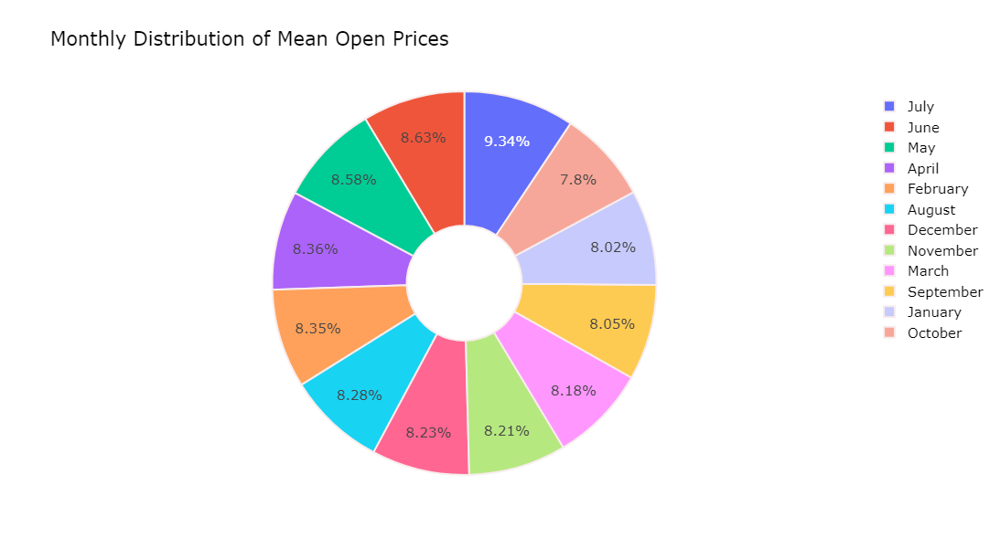

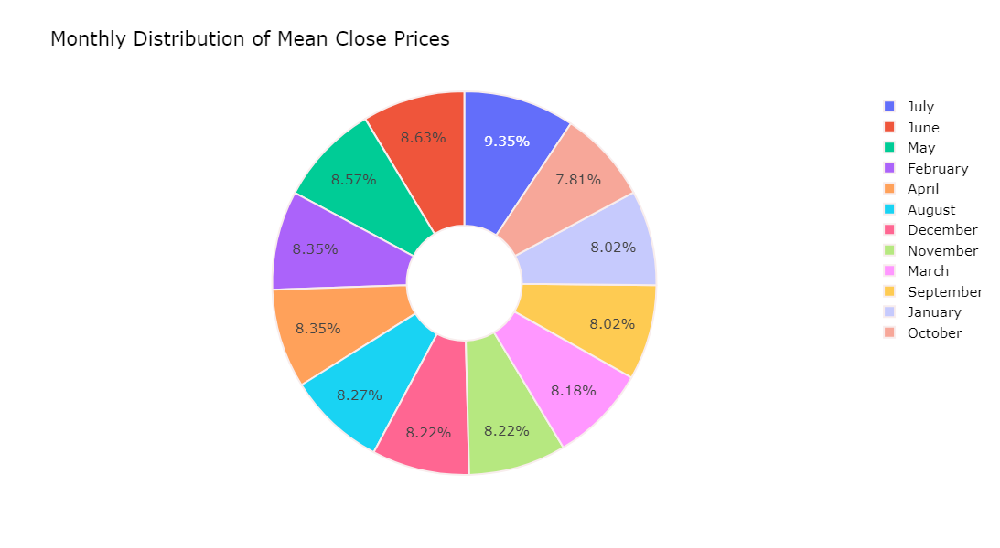

In [629]:
# Plotting Monthly Distribution of Mean Open and Close Prices

# Extracting month and year from the 'Date'
df['YearMonth'] = df['Date'].dt.to_period('M')
df['Month'] = df['Date'].dt.month_name()

# Calculating mean open and close prices per month
monthly_mean = df.groupby('Month').agg({
    'Open': 'mean',
    'Close': 'mean'
}).reindex([
    'January', 'February', 'March', 'April', 'May', 'June',
    'July', 'August', 'September', 'October', 'November', 'December'
]).reset_index()

fig1 = go.Figure()

fig1.add_trace(go.Pie(
    labels=monthly_mean['Month'],
    values=monthly_mean['Open'],
    name='Mean Open Price',
    hole=0.3,  
    marker=dict(line=dict(color='#F8EDED', width=2))  
))

fig1.update_layout(
    title='Monthly Distribution of Mean Open Prices',
    width=800,  
    height=600,  
    plot_bgcolor='#FEFFD2',  
    font_size=15, 
    font_color='black'  
)

fig2 = go.Figure()

fig2.add_trace(go.Pie(
    labels=monthly_mean['Month'],
    values=monthly_mean['Close'],
    name='Mean Close Price',
    hole=0.3,  #
    marker=dict(line=dict(color='#F8EDED', width=2))  
))

fig2.update_layout(
    title='Monthly Distribution of Mean Close Prices',
    width=800,  # Setting plot width
    height=600,  # Setting plot height
    plot_bgcolor='#E0E5B6',  
    font_size=15,  
    font_color='black' 
)

# Showing the figures
fig1.show()
fig2.show()


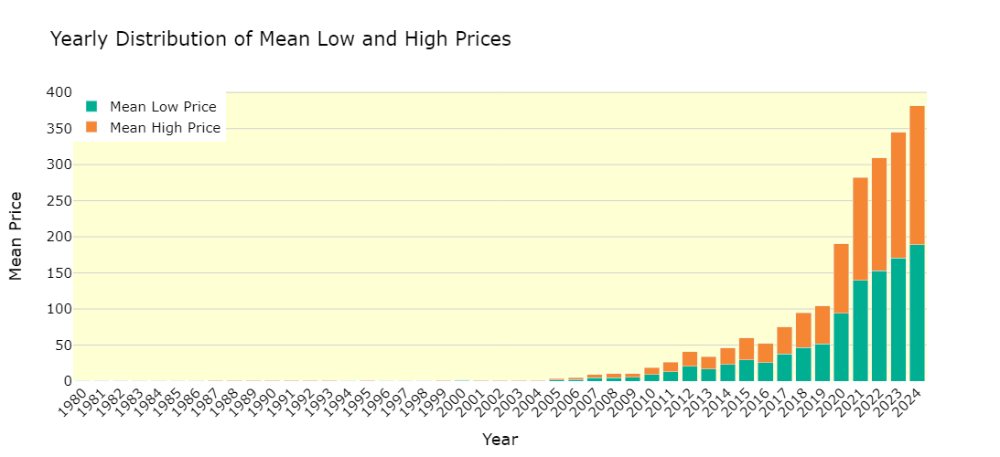

In [623]:
# plotting Yearly Distribution of Mean Low and High Prices
# Calculating Low and High prices per year
yearly_mean = df.groupby('Year').agg({
    'Low': 'mean',
    'High': 'mean'
}).reset_index()

# Creating a bar plot
fig = go.Figure()

# Adding bars for mean low prices
fig.add_trace(go.Bar(
    x=yearly_mean['Year'],
    y=yearly_mean['Low'],
    name='Mean Low Price',
    marker_color='#00AF91'
))

# Adding bars for mean high prices
fig.add_trace(go.Bar(
    x=yearly_mean['Year'],
    y=yearly_mean['High'],
    name='Mean High Price',
    marker_color='#F58634'
))

# Updating the layout for stacked bar plot
fig.update_layout(
    title='Yearly Distribution of Mean Low and High Prices',
    xaxis_title='Year',
    yaxis_title='Mean Price',
    plot_bgcolor='#FEFFD2',
    font_size=15,
    font_color='black',
    width=1100,  
    height=500,  
    barmode='stack',  
    legend=dict(
        x=0,  
        y=1,
        traceorder='normal',
        orientation='v'  
    )
)

fig.update_xaxes(
    tickmode='array',  
    tickvals=yearly_mean['Year'],  
    ticktext=[str(year) for year in yearly_mean['Year']],  
    tickangle=-45 
)

fig.update_yaxes(
    showgrid=True,
    gridcolor='LightGray'
)

# Showing the figure
fig.show()


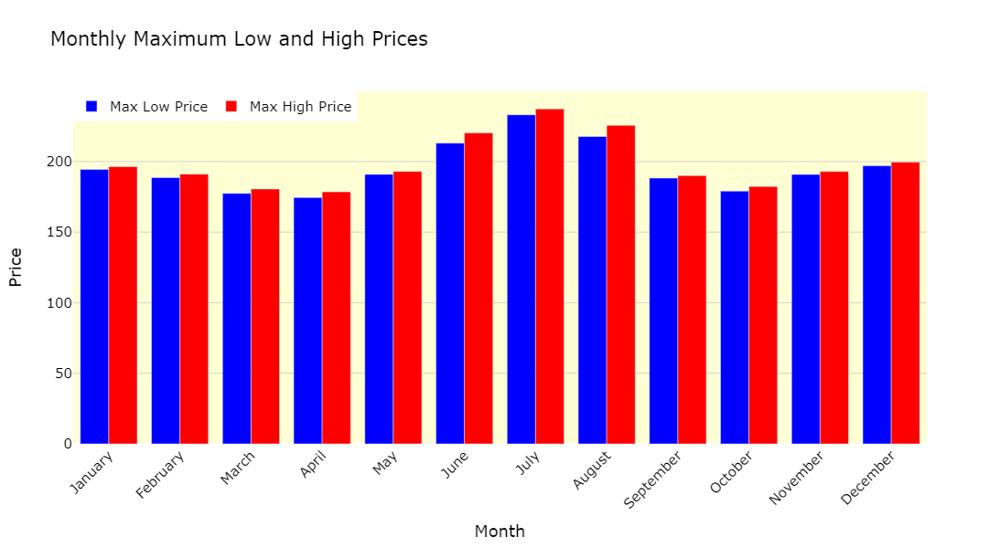

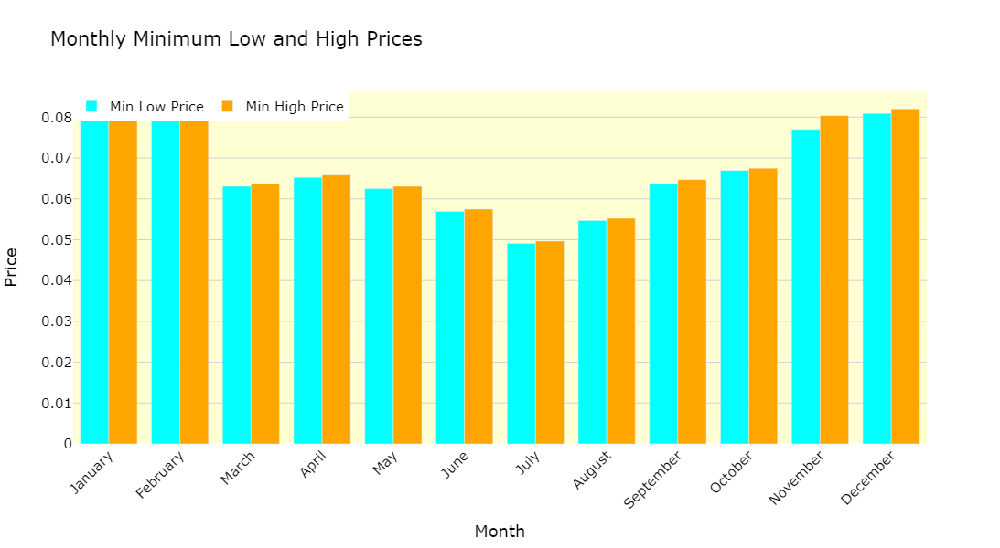

In [635]:
# Max and Min of Low and High Prices Monthly Distribution

# Extracting month and year from 'Date'
df['YearMonth'] = df['Date'].dt.to_period('M')
df['Month'] = df['Date'].dt.month_name()

# Calculating max and min Low and High prices per month
monthly_stats = df.groupby('Month').agg({
    'Low': ['max', 'min'],
    'High': ['max', 'min']
}).reindex([
    'January', 'February', 'March', 'April', 'May', 'June',
    'July', 'August', 'September', 'October', 'November', 'December'
]).reset_index()

# Flattening the columns
monthly_stats.columns = ['Month', 'Max_Low', 'Min_Low', 'Max_High', 'Min_High']

# Create a bar plot for Maximum Prices
fig_max = go.Figure()

# Add bars for maximum low prices
fig_max.add_trace(go.Bar(
    x=monthly_stats['Month'],
    y=monthly_stats['Max_Low'],
    name='Max Low Price',
    marker_color='blue'
))

# Add bars for maximum high prices
fig_max.add_trace(go.Bar(
    x=monthly_stats['Month'],
    y=monthly_stats['Max_High'],
    name='Max High Price',
    marker_color='red'
))

# Update layout 
fig_max.update_layout(
    title='Monthly Maximum Low and High Prices',
    xaxis_title='Month',
    yaxis_title='Price',
    plot_bgcolor='#FEFFD2',
    font_size=15,
    font_color='black',
    width=1100,  
    height=600,  
    barmode='group',  
    legend=dict(
        x=0.0,  
        y=1,
        traceorder='normal',
        orientation='h' 
    )
)

fig_max.update_xaxes(
    tickmode='array',  
    tickvals=monthly_stats['Month'],  
    ticktext=monthly_stats['Month'], 
    tickangle=-45  
)

fig_max.update_yaxes(
    showgrid=True,
    gridcolor='LightGray'
)

# Show the figure for maximum prices
fig_max.show()

# Creating a bar plot for Minimum Prices
fig_min = go.Figure()

# Add bars for minimum Low prices
fig_min.add_trace(go.Bar(
    x=monthly_stats['Month'],
    y=monthly_stats['Min_Low'],
    name='Min Low Price',
    marker_color='cyan'
))

# Add bars for minimum High prices
fig_min.add_trace(go.Bar(
    x=monthly_stats['Month'],
    y=monthly_stats['Min_High'],
    name='Min High Price',
    marker_color='orange'
))

# Update layout 
fig_min.update_layout(
    title='Monthly Minimum Low and High Prices',
    xaxis_title='Month',
    yaxis_title='Price',
    plot_bgcolor='#FEFFD2',
    font_size=15,
    font_color='black',
    width=1100, 
    height=600,  
    barmode='group',  
    legend=dict(
        x=0.0,  
        y=1,
        traceorder='normal',
        orientation='h'  
    )
)

fig_min.update_xaxes(
    tickmode='array',  
    ticktext=monthly_stats['Month'],  
    tickangle=-45  
)

fig_min.update_yaxes(
    showgrid=True,
    gridcolor='LightGray'
)

# Show the figure for minimum prices
fig_min.show()


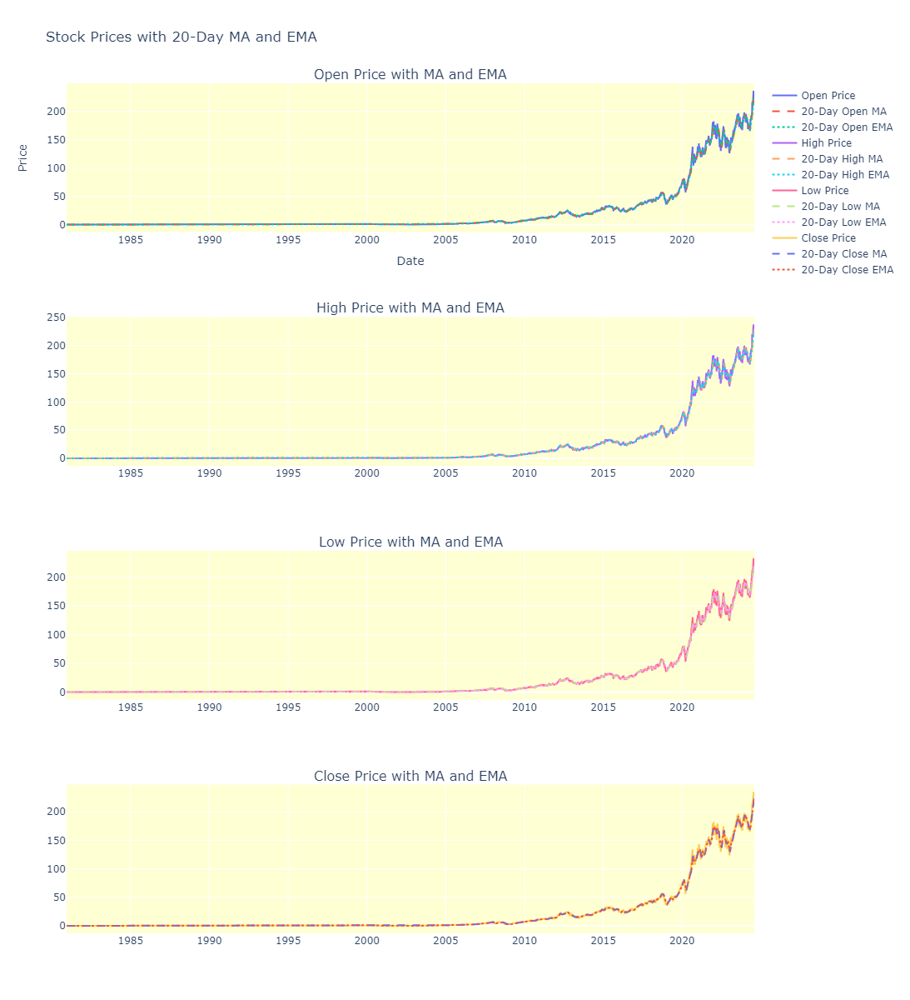

In [637]:
# Calculating  Moving Average (MA) and Exponential Moving Average (EMA)
window_size = 20  
for column in ['Open', 'High', 'Low', 'Close']:
    df[f'{column}_MA'] = df[column].rolling(window=window_size).mean()
    df[f'{column}_EMA'] = df[column].ewm(span=window_size, adjust=False).mean()

# Creating subplots
fig = make_subplots(
    rows=4, cols=1,
    subplot_titles=('Open Price with MA and EMA', 'High Price with MA and EMA', 
                    'Low Price with MA and EMA', 'Close Price with MA and EMA'),
    vertical_spacing=0.1
)

# Adding traces for each price type
for i, column in enumerate(['Open', 'High', 'Low', 'Close'], start=1):
    fig.add_trace(
        go.Scatter(x=df['Date'], y=df[column], mode='lines', name=f'{column} Price'),
        row=i, col=1
    )
    fig.add_trace(
        go.Scatter(x=df['Date'], y=df[f'{column}_MA'], mode='lines', name=f'{window_size}-Day {column} MA', line=dict(dash='dash')),
        row=i, col=1
    )
    fig.add_trace(
        go.Scatter(x=df['Date'], y=df[f'{column}_EMA'], mode='lines', name=f'{window_size}-Day {column} EMA', line=dict(dash='dot')),
        row=i, col=1
    )

# Updatig layout
fig.update_layout(
    height=1200,
    width=1000,
    title_text=f"Stock Prices with {window_size}-Day MA and EMA",
    xaxis_title="Date",
    yaxis_title="Price", plot_bgcolor='#FEFFD2'
)

# Showing plot
fig.show()

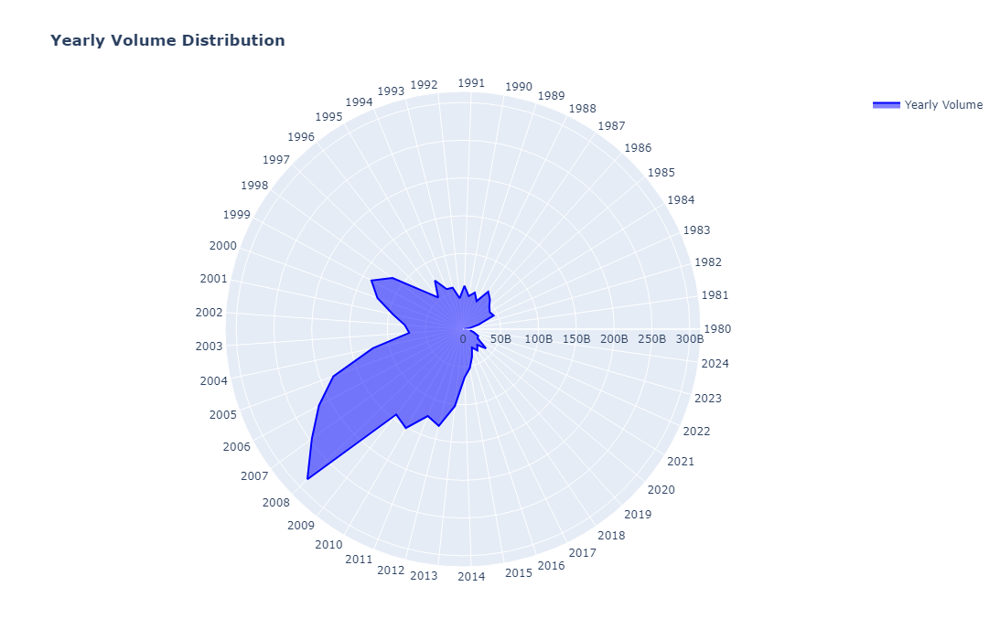

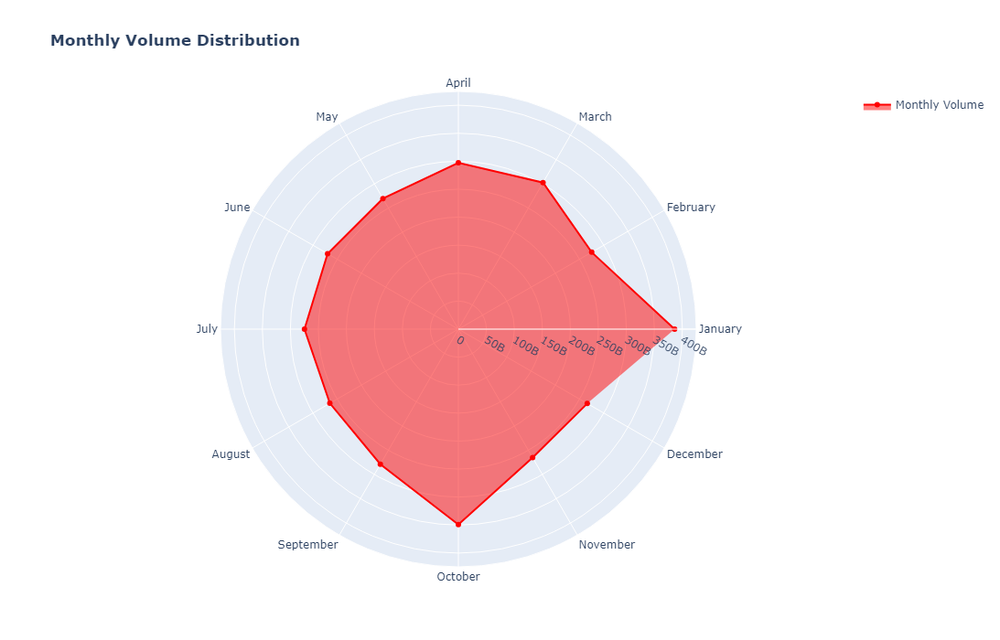

In [21]:
# Plotting Yearly and Monthly distribution of Volumes of shares
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month_name()

# Calculating volume per year
yearly_volume = df.groupby('Year')['Volume'].sum().reset_index()

# Calculating volume per month
monthly_volume = df.groupby('Month')['Volume'].sum().reindex([
    'January', 'February', 'March', 'April', 'May', 'June',
    'July', 'August', 'September', 'October', 'November', 'December'
]).reset_index()

plot_width = 700
plot_height = 700

fig_yearly = go.Figure()

fig_yearly.add_trace(go.Scatterpolar(
    r=yearly_volume['Volume'],
    theta=yearly_volume['Year'].astype(str),
    fill='toself',
    name='Yearly Volume',
    line=dict(color='blue')
))

# Update layout for yearly volume radar plot
fig_yearly.update_layout(
    title='<b>Yearly Volume Distribution</b>',
    width=plot_width,
    height=plot_height,
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, yearly_volume['Volume'].max() * 1.1]  # Set range dynamically
        )
    ),
    showlegend=True
)

# Show the yearly volume radar plot
fig_yearly.show()

# Create the radar plot for monthly volume
fig_monthly = go.Figure()

fig_monthly.add_trace(go.Scatterpolar(
    r=monthly_volume['Volume'],
    theta=monthly_volume['Month'],
    fill='toself',
    name='Monthly Volume',
    line=dict(color='red')
))

# Update layout for monthly volume radar plot
fig_monthly.update_layout(
    title='<b>Monthly Volume Distribution</b>',
    width=plot_width,
    height=plot_height,
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, monthly_volume['Volume'].max() * 1.1]  # Set range dynamically
        )
    ),
    showlegend=True
)

# Show the monthly volume radar plot
fig_monthly.show()


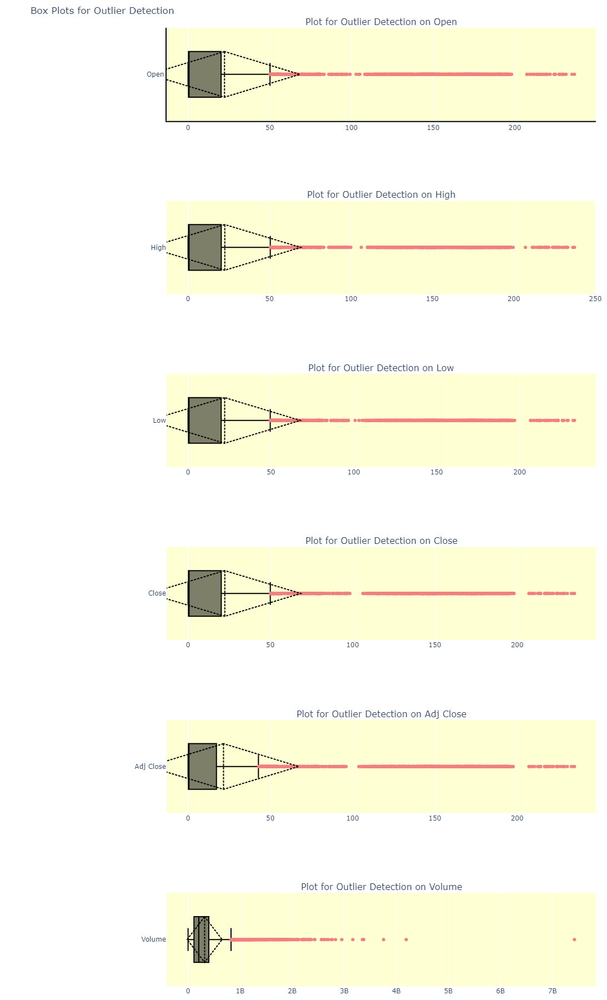

In [639]:
# Plotting Box plot to understand the outliers in the data
# Creating subplots
fig = make_subplots(
    rows=len(Column_List), 
    cols=1, 
    subplot_titles=[f'Plot for Outlier Detection on {col}' for col in Column_List]
)

# Adding box plots 
for i, col in enumerate(Column_List):
    fig.add_trace(
        go.Box(
            x=df[col], 
            name=col, 
            boxmean='sd', 
            marker_color='lightcoral',
            line=dict(
                color='black',  # Border color of the boxes
                width=2  # Border width of the boxes
            )
        ),
        row=i+1, col=1
    )

# Update layout
fig.update_layout(
    height=300 * len(Column_List),  
    width=800,  # Custom width
    title_text="Box Plots for Outlier Detection",
    plot_bgcolor='#FEFFD2',  
    paper_bgcolor='#FFFFFF',
    margin=dict(l=300, r=10, t=50, b=10),  
    showlegend=False,
    xaxis=dict(
        showline=True,
        linecolor='black',  # Border color for x-axis
        linewidth=2  # Border width for x-axis
    ),
    yaxis=dict(
        showline=True,
        linecolor='black',  # Border color for y-axis
        linewidth=2  # Border width for y-axis
    )
)

# Showing plot
fig.show()

In [23]:
df.shape           # shape of data before removing the outliers

(11001, 18)

In [200]:
# Define the columns to check for outliers
columns_to_check = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']

# Initializing an empty DataFrame to store the filtered data
filtered_data = pd.DataFrame()

for column in columns_to_check:
    # Calculating Q1 (25th percentile) and Q3 (75th percentile)
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    
    # Calculating IQR
    IQR = Q3 - Q1
    
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Filtering data based on the bounds
    filtered_data = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    
    if filtered_data.empty:
        print(f"Warning: No data left after filtering column '{column}'")
        break

# Resetting the index after filtering
filtered_data = filtered_data.reset_index(drop=True)

In [201]:
filtered_data.shape              # shape of data after removing the outliers

(10206, 18)

# Feature Engineering

In [202]:
filtered_data = filtered_data[['Date','Open']]   #  separating dataframe of open price
filtered_data1 = filtered_data.copy()
print("Total Rows for prediction: ",filtered_data.shape[0])

Total Rows for prediction:  10206


In [203]:
del filtered_data['Date']
scaler=MinMaxScaler(feature_range=(0,1))          # normalising the data using min max scalar
filtered_data=scaler.fit_transform(np.array(filtered_data).reshape(-1,1))

In [205]:
train_size=int(len(filtered_data)*0.90)          # splitting data into training and test data
test_size=len(filtered_data)-train_size
train_data,test_data=filtered_data[0:train_size,:],filtered_data[train_size:len(filtered_data),:1]
print("shape of training data: ", train_data.shape)
print("shape of test data: ", test_data.shape)

shape of training data:  (9185, 1)
shape of test data:  (1021, 1)


In [207]:
def data_prep(data, time_steps=15):
    X, Y = [], []
    for i in range(len(data)-time_steps-1):
        new_data = data[i:(i+time_steps), 0]   
        X.append(new_data)
        Y.append(data[i + time_steps, 0])
    return np.array(X), np.array(Y)

In [212]:
time_steps = 100          # creating set of the data for training using time step of 100
X_train, Y_train = data_prep(train_data, time_steps)
X_test, Y_test = data_prep(test_data, time_steps)

print("Shape of X_train: ", X_train.shape)
print("Shape of Y_train: ", Y_train.shape)
print("Shape of X_test: ", X_test.shape)
print("Shape of Y_test", Y_test.shape)

Shape of X_train:  (9084, 100)
Shape of Y_train:  (9084,)
Shape of X_test:  (920, 100)
Shape of Y_test (920,)


# Model Implementation

# CNN Model

In [215]:
x_train_ = X_train.reshape(X_train.shape[0],1, X_train.shape[1])    # reshaping the data for CNN Model
x_test_ = X_test.reshape(X_test.shape[0],1, X_test.shape[1])

In [267]:
model_cnn =Sequential()    #adding sequential layer 
model_cnn.add(tf.keras.layers.Input(shape=(1, X_train.shape[1])))   # adding input layer
model_cnn.add(tf.keras.layers.BatchNormalization())   # adding batch normalisation layer
model_cnn.add(tf.keras.layers.Conv1D(filters=100, kernel_size=1, activation='relu'))   # adding conv 1d layer with 100 filters
model_cnn.add(tf.keras.layers.BatchNormalization())   # adding batch normalisation layer
model_cnn.add(tf.keras.layers.Dropout(0.4))   # adding dropout layers
model_cnn.add(tf.keras.layers.Conv1D(filters=50, kernel_size=1, activation='relu'))   # adding conv 1d layer with 50 filters
model_cnn.add(tf.keras.layers.BatchNormalization())   # adding batch normalisation layer
model_cnn.add(tf.keras.layers.Dropout(0.2))   # adding dropout layers
model_cnn.add(tf.keras.layers.Flatten())   # adding flatten layer
model_cnn.add(tf.keras.layers.Dense(512,activation='relu'))    # adding dense layers
model_cnn.add(tf.keras.layers.Dropout(0.3))      # adding dropout layers
model_cnn.add(tf.keras.layers.Dense(200,activation='relu'))      # adding dense layers
model_cnn.add(tf.keras.layers.Dropout(0.2))      # adding dropout layers
model_cnn.add(tf.keras.layers.Dense(60,activation='relu'))      # adding dense layers
model_cnn.add(tf.keras.layers.Dropout(0.2))      # adding dropout layers
model_cnn.add(tf.keras.layers.Dense(1,activation = 'linear'))    # adding prediction layer
model_cnn.compile(loss='mean_squared_error', optimizer='adam')  # compiling model
model_cnn.summary()

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ batch_normalization_29          │ (None, 1, 100)         │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_16 (Conv1D)              │ (None, 1, 100)         │        10,100 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 1, 100)         │           400 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_56 (Dropout)            │ (None, 1, 100)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_17 (Conv1D)              │ (None, 1, 50)          │         5,050 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 1, 50)          │           200 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_57 (Dropout)            │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 50)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 512)            │        26,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_58 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 200)            │       102,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_59 (Dropout)            │ (None, 200)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 60)             │        12,060 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_60 (Dropout)            │ (None, 60)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 1)              │            61 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 156,983 (613.21 KB)

 Trainable params: 156,483 (611.26 KB)

 Non-trainable params: 500 (1.95 KB)

In [268]:
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',       # Metric to monitor, usually 'val_loss' or 'val_accuracy'
    factor=0.5,               # Factor by which the learning rate will be reduced
    patience=1,               # Number of epochs with no improvement after which learning rate will be reduced
    min_lr=1e-6               # Lower bound on the learning rate
)
history1 = model_cnn.fit(x_train_, Y_train, epochs=30, batch_size=64, validation_data=(x_test_, Y_test),callbacks=[reduce_lr])   # training model using training data

Epoch 1/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - loss: 0.0218 - val_loss: 0.4063 - learning_rate: 0.0010
Epoch 2/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.0014 - val_loss: 0.3251 - learning_rate: 0.0010
Epoch 3/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0010 - val_loss: 0.2021 - learning_rate: 0.0010
Epoch 4/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 9.4060e-04 - val_loss: 0.1143 - learning_rate: 0.0010
Epoch 5/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 7.7167e-04 - val_loss: 0.0482 - learning_rate: 0.0010
Epoch 6/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 7.0507e-04 - val_loss: 0.0609 - learning_rate: 0.0010
Epoch 7/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 6.5693e-04 - val_loss: 0.0139 - learning_rate: 5.0000e-04
Epoch 8/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 6.6809e-04 - val_loss: 0.0945 - learning_rate: 5.0000e-04
Epoch 9/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 7.2618e-04 - val_loss: 0.0265 -

In [270]:
# Prediction on train and test data
train_predictions=model_cnn.predict(x_train_)
test_predictions=model_cnn.predict(x_test_)

284/284 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step


In [271]:
# inverse transforming the outputs
train_prediction = scaler.inverse_transform(train_predictions)
test_prediction = scaler.inverse_transform(test_predictions)
true_ytrain = scaler.inverse_transform(Y_train.reshape(-1,1)) 
true_ytest = scaler.inverse_transform(Y_test.reshape(-1,1)) 

In [272]:
# Calculating Metrics for CNN model
def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)  
    mde = np.median(np.abs(y_true - y_pred))
    
    return mae, mse, rmse, mde


mae_cnn, mse_cnn, rmse_cnn, mde_cnn = evaluate_model(true_ytest, test_prediction)
print(f"MAE: {mae_cnn}")
print(f"MSE: {mse_cnn}")
print(f"RMSE: {rmse_cnn}")
print(f"MDE: {mde_cnn}")

MAE: 36.813070520858105
MSE: 1411.2921248426003
RMSE: 37.5671681770479
MDE: 36.305786048339854


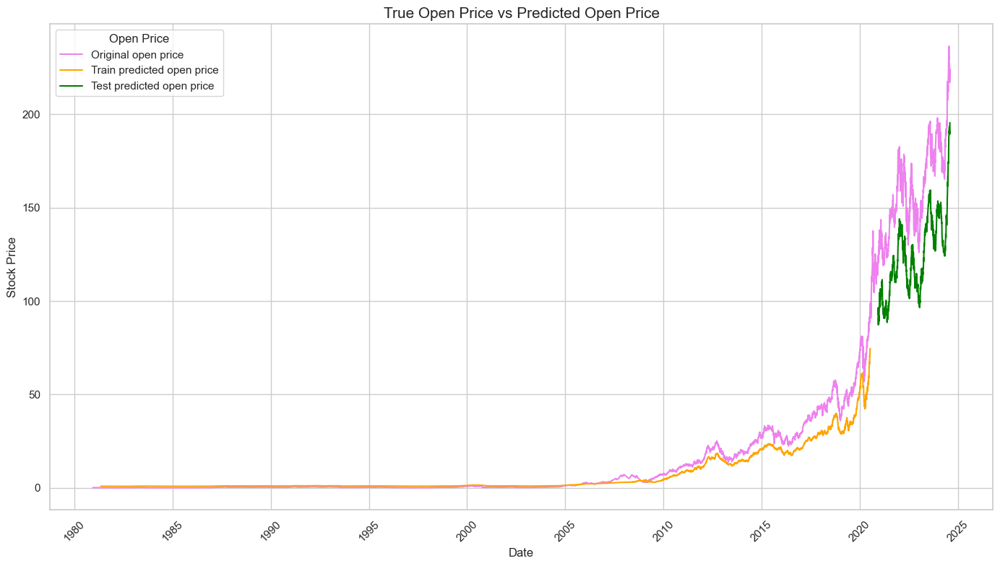

In [291]:
# Generate data for plotting
look_back = time_steps
trainPredictPlot = np.empty_like(filtered_data)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_prediction)+look_back, :] = train_prediction

testPredictPlot = np.empty_like(filtered_data)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_prediction)+(look_back*2)+1:len(filtered_data)-1, :] = test_prediction

# Preparing DataFrame for plotting
plotdf = pd.DataFrame({
    'date': filtered_data1['Date'],
    'original_open': filtered_data1['Open'],
    'train_predicted_open': trainPredictPlot.reshape(1, -1)[0],
    'test_predicted_open': testPredictPlot.reshape(1, -1)[0]
})

plt.figure(figsize=(14, 8))
sns.set(style="whitegrid")

# Plot original open prices
sns.lineplot(data=plotdf, x='date', y='original_open', label='Original open price', color='violet')

# Plot train predicted prices
sns.lineplot(data=plotdf, x='date', y='train_predicted_open', label='Train predicted open price', color='orange')

# Plot test predicted prices
sns.lineplot(data=plotdf, x='date', y='test_predicted_open', label='Test predicted open price', color='green')

plt.title('True Open Price vs Predicted Open Price', fontsize=15)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Stock Price', fontsize=12)
plt.legend(title='Open Price')
plt.grid(True)
plt.xticks(rotation=45)  # Rotating x-axis labels for better readability
plt.tight_layout()  # Adjusting layout to fit labels

# Showing plot
plt.show()

# RNN Model

In [415]:
#Building RNN model
model_rnn=Sequential()                                # adding first layera as seq layer
model_rnn.add(tf.keras.layers.Input(shape=(100,1)))    # adding input layer
model_rnn.add(tf.keras.layers.BatchNormalization())    # adding batch normalization layer
model_rnn.add(SimpleRNN(80,return_sequences=True))      # Adding RNN layer with 80 neurons
model_rnn.add(Dropout(0.3))   # adding dropout layer to avoid overfitting of model
model_rnn.add(SimpleRNN(80,return_sequences=True))      # Adding RNN layer with 80 neurons
model_rnn.add(Dropout(0.3))   # adding dropout layer to avoid overfitting of model
model_rnn.add(SimpleRNN(80))      # Adding RNN layer with 80 neurons
model_rnn.add(Dropout(0.3))   # adding dropout layer to avoid overfitting of model
model_rnn.add(Dense(1,activation="linear"))  # adding output layer with 1 neurons
model_rnn.compile(loss='mean_squared_error',optimizer='adam')
model_rnn.summary()

Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ batch_normalization_38          │ (None, 100, 1)         │             4 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_19 (SimpleRNN)       │ (None, 100, 80)        │         6,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_75 (Dropout)            │ (None, 100, 80)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_20 (SimpleRNN)       │ (None, 100, 80)        │        12,880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_76 (Dropout)            │ (None, 100, 80)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_21 (SimpleRNN)       │ (None, 80)             │        12,880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_77 (Dropout)            │ (None, 80)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 1)              │            81 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 32,405 (126.58 KB)

 Trainable params: 32,403 (126.57 KB)

 Non-trainable params: 2 (8.00 B)

In [417]:
reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',       # Metric to monitor, usually 'val_loss' or 'val_accuracy'
    factor=0.5,               # Factor by which the learning rate will be reduced
    patience=3,               # Number of epochs with no improvement after which learning rate will be reduced
    min_lr=1e-6               # Lower bound on the learning rate
)
history2 = model_rnn.fit(X_train, Y_train, epochs=30, batch_size=64, validation_data=(X_test, Y_test),callbacks = [reduce_lr])  # training model using training data

Epoch 1/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 26s 135ms/step - loss: 0.3231 - val_loss: 0.2231 - learning_rate: 0.0010
Epoch 2/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 19s 132ms/step - loss: 0.0385 - val_loss: 0.1975 - learning_rate: 0.0010
Epoch 3/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 20s 141ms/step - loss: 0.0162 - val_loss: 0.1153 - learning_rate: 0.0010
Epoch 4/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 20s 144ms/step - loss: 0.0095 - val_loss: 0.0171 - learning_rate: 0.0010
Epoch 5/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 18s 129ms/step - loss: 0.0065 - val_loss: 0.0074 - learning_rate: 0.0010
Epoch 6/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 19s 134ms/step - loss: 0.0046 - val_loss: 0.0036 - learning_rate: 0.0010
Epoch 7/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 21s 149ms/step - loss: 0.0036 - val_loss: 0.0023 - learning_rate: 0.0010
Epoch 8/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 16s 115ms/step - loss: 0.0026 - val_loss: 0.0066 - learning_rate: 0.0010
Epoch 9/30
142/142 ━━━━━━━━━━━━━━━━━━━━ 17s 119ms/step - loss: 0.0022 - val_loss: 0.0027 - learn

In [418]:
# Predictions on train and test data
train_predictions=model_rnn.predict(X_train)
test_predictions=model_rnn.predict(X_test)

284/284 ━━━━━━━━━━━━━━━━━━━━ 47s 48ms/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step


In [419]:
# Transform predictions back to original form
train_prediction = scaler.inverse_transform(train_predictions)
test_prediction = scaler.inverse_transform(test_predictions)
true_ytrain = scaler.inverse_transform(Y_train.reshape(-1,1)) 
true_ytest = scaler.inverse_transform(Y_test.reshape(-1,1)) 

In [427]:
# Calculating the Metrics from RNN model
def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)  
    mde = np.median(np.abs(y_true - y_pred))
    
    return mae, mse, rmse, mde


mae_rnn, mse_rnn, rmse_rnn, mde_rnn = evaluate_model(true_ytest, test_prediction)
print(f"MAE: {mae_rnn}")
print(f"MSE: {mse_rnn}")
print(f"RMSE: {rmse_rnn}")
print(f"MDE: {mde_rnn}")

MAE: 16.108348249063244
MSE: 338.4518203243666
RMSE: 18.397060100036818
MDE: 15.099487525390629


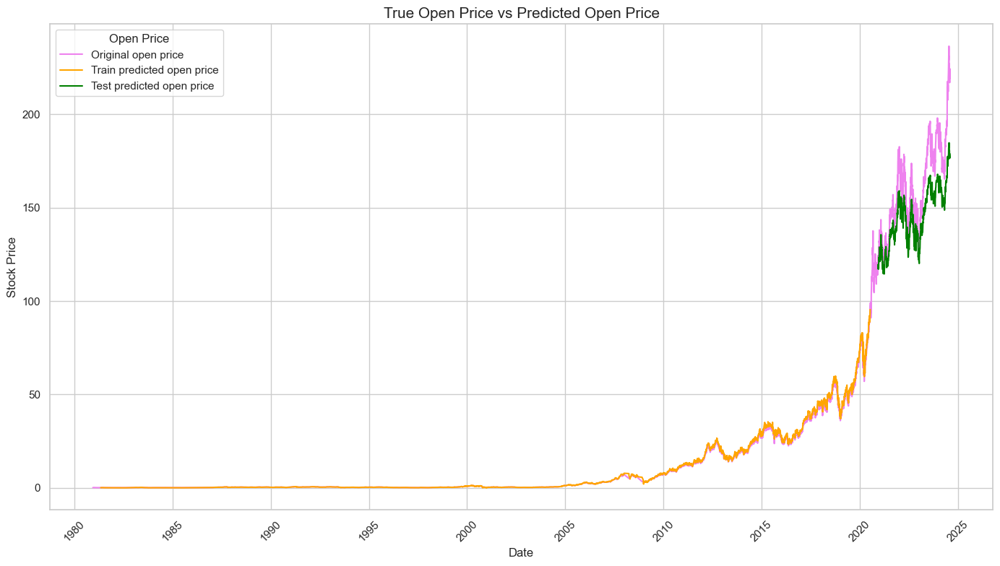

In [429]:
# Generating data for plotting
look_back = time_steps
trainPredictPlot = np.empty_like(filtered_data)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_prediction)+look_back, :] = train_prediction

testPredictPlot = np.empty_like(filtered_data)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_prediction)+(look_back*2)+1:len(filtered_data)-1, :] = test_prediction

# Preparing DataFrame for plotting
plotdf = pd.DataFrame({
    'date': filtered_data1['Date'],
    'original_open': filtered_data1['Open'],
    'train_predicted_open': trainPredictPlot.reshape(1, -1)[0],
    'test_predicted_open': testPredictPlot.reshape(1, -1)[0]
})

plt.figure(figsize=(14, 8))
sns.set(style="whitegrid")

# Plot original open prices
sns.lineplot(data=plotdf, x='date', y='original_open', label='Original open price', color='violet')

# Plot train predicted prices
sns.lineplot(data=plotdf, x='date', y='train_predicted_open', label='Train predicted open price', color='orange')

# Plot test predicted prices
sns.lineplot(data=plotdf, x='date', y='test_predicted_open', label='Test predicted open price', color='green')

plt.title('True Open Price vs Predicted Open Price', fontsize=15)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Stock Price', fontsize=12)
plt.legend(title='Open Price')
plt.grid(True)
plt.xticks(rotation=45)  
plt.tight_layout()  

# Showing plot
plt.show()

# GAN Model

In [443]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, LeakyReLU, BatchNormalization, Reshape, RepeatVector, Dropout
from tensorflow.keras.optimizers import Adam

# Defining the generator model
def build_generator(time_step):
    model = Sequential()
    model.add(Dense(512, input_dim=time_step, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(264, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(time_step, activation='linear'))  # Output sequence of the same length as input
    model.compile(loss='mean_squared_error', optimizer=Adam(learning_rate=0.0001, beta_1=0.5))
    return model

# Defining the discriminator model with LSTM
def build_discriminator(time_step):
    model = Sequential()
    model.add(LSTM(80, input_shape=(time_step, 1), return_sequences=True))
    model.add(Dropout(0.2))
    model.add(LSTM(80, return_sequences=True))
    model.add(Dropout(0.3))
    model.add(LSTM(80))
    model.add(Dropout(0.3))
    model.add(Dense(1, activation='linear'))  # Output a single value for regression
    model.compile(loss='mean_squared_error', optimizer=Adam(learning_rate=0.0001, beta_1=0.5))
    return model

# Defining the GAN model
def build_gan(generator, discriminator):
    model = Sequential()
    model.add(generator)
    discriminator.trainable = False
    model.add(Reshape((generator.output_shape[1], 1)))  # Reshape to match input shape
    model.add(discriminator)
    model.compile(loss='mean_squared_error', optimizer=Adam(learning_rate=0.0001, beta_1=0.5))
    return model

# Training the GAN model
def train_gan(X_train, epochs=50, batch_size=8):
    time_step = X_train.shape[1]
    generator = build_generator(time_step)
    discriminator = build_discriminator(time_step)
    gan = build_gan(generator, discriminator)

    for epoch in range(epochs):
        # Generating fake data
        noise = np.random.normal(0, 1, (batch_size, time_step))
        fake_data = generator.predict(noise)

        # Getting a random batch of real data
        idx = np.random.randint(0, X_train.shape[0], batch_size)
        real_data = X_train[idx]

        # Reshaping real_data and fake_data for LSTM input
        real_data_reshaped = np.expand_dims(real_data, axis=-1)
        fake_data_reshaped = np.expand_dims(fake_data, axis=-1)

        # Training discriminator
        d_loss_real = discriminator.train_on_batch(real_data_reshaped, real_data)
        d_loss_fake = discriminator.train_on_batch(fake_data_reshaped, fake_data)
        d_loss = 0.5 * (d_loss_real + d_loss_fake)

        # Training generator
        noise = np.random.normal(0, 1, (batch_size, time_step))
        g_loss = gan.train_on_batch(noise, noise)  # We use noise as the target for the generator

        if (epoch + 1) % 10 == 0:
            print(f"{epoch + 1}/{epochs} [D loss: {d_loss}] [G loss: {g_loss}]")

    return generator


generator = train_gan(X_train)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 967ms/step
10/50 [D loss: 0.07786345481872559] [G loss: [array(0.08005075, dtype=float32), array(0.08005075, dtype=float32), array(0.08005075, dtype=float32)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
20/50 [D loss: 0.07866464555263519] [G loss: [array(0.07939563, dtype=float32), array(0

In [444]:
# Predictions on train and test data
train_predictions = generator.predict(X_train)
train_predictions = train_predictions[:, -1]
test_predictions = generator.predict(X_test)
test_predictions = test_predictions[:, -1]

284/284 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [445]:
# Transforming predictions back to original data
train_prediction = scaler.inverse_transform(train_predictions.reshape(-1,1))
test_prediction = scaler.inverse_transform(test_predictions.reshape(-1,1))
true_ytrain = scaler.inverse_transform(Y_train.reshape(-1,1)) 
true_ytest = scaler.inverse_transform(Y_test.reshape(-1,1)) 

In [446]:
# Calculating the Metrics for GAN model
def evaluate_model(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse) 
    mde = np.median(np.abs(y_true - y_pred))
    
    return mae, mse, rmse, mde

mae_gan, mse_gan, rmse_gan, mde_gan = evaluate_model(true_ytest, test_prediction)
print(f"MAE: {mae_gan}")
print(f"MSE: {mse_gan}")
print(f"RMSE: {rmse_gan}")
print(f"MDE: {mde_gan}")

MAE: 108.37233742809394
MSE: 12089.147855122712
RMSE: 109.95066100357337
MDE: 106.51947983605956


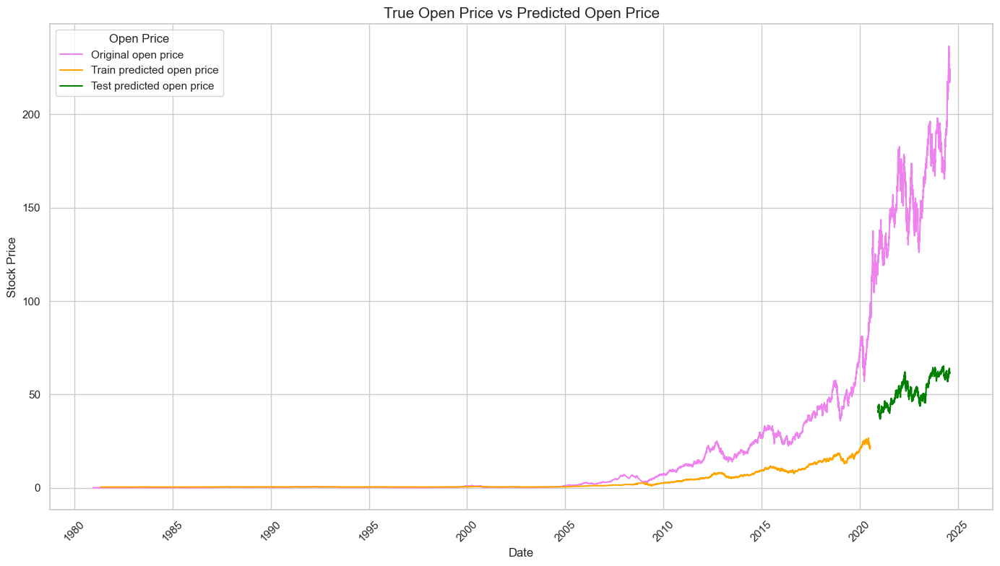

In [447]:
# Generating data for plotting
look_back = time_steps
trainPredictPlot = np.empty_like(filtered_data)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(train_prediction)+look_back, :] = train_prediction

testPredictPlot = np.empty_like(filtered_data)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(train_prediction)+(look_back*2)+1:len(filtered_data)-1, :] = test_prediction

# Preparing DataFrame for plotting
plotdf = pd.DataFrame({
    'date': filtered_data1['Date'],
    'original_open': filtered_data1['Open'],
    'train_predicted_open': trainPredictPlot.reshape(1, -1)[0],
    'test_predicted_open': testPredictPlot.reshape(1, -1)[0]
})

plt.figure(figsize=(14, 8))
sns.set(style="whitegrid")

# Plotting original open prices
sns.lineplot(data=plotdf, x='date', y='original_open', label='Original open price', color='violet')

# Plotting train predicted prices
sns.lineplot(data=plotdf, x='date', y='train_predicted_open', label='Train predicted open price', color='orange')

# Plotting test predicted prices
sns.lineplot(data=plotdf, x='date', y='test_predicted_open', label='Test predicted open price', color='green')

plt.title('True Open Price vs Predicted Open Price', fontsize=15)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Stock Price', fontsize=12)
plt.legend(title='Open Price')
plt.grid(True)
plt.xticks(rotation=45)  
plt.tight_layout()  
# Showing plot
plt.show()

# Comparison of Models

In [453]:
Model_Results = {'MAE':[mae_cnn,mae_rnn, mae_gan], # creating data contains metrics of evaluation
        'MSE':[mse_cnn,mse_rnn,mse_gan],
        'RMSE':[rmse_cnn,rmse_rnn,rmse_gan],
        'MDE':[mde_cnn,mde_rnn,mde_gan],
        'Algo':['CNN','RNN','GAN'] }
Model_Results = pd.DataFrame(Model_Results)        # making dataframe of data

In [455]:
Model_Results          # results of model on different metrics

,MAE,MSE,RMSE,MDE,Algo
0,36.813071,1411.292125,37.567168,36.305786,CNN
1,16.108348,338.451820,18.397060,15.099488,RNN
2,108.372337,12089.147855,109.950661,106.519480,GAN


# MAE Comparison

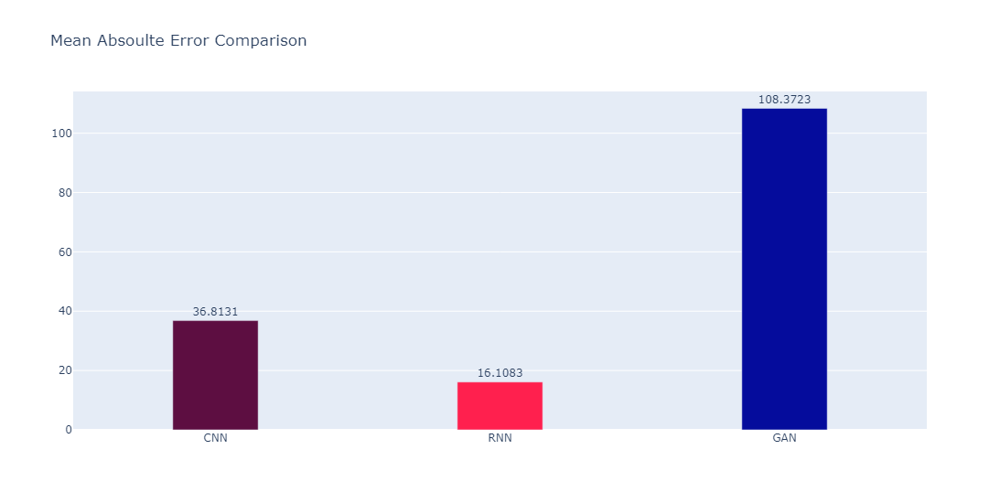

In [650]:
# plotting bar plot to comapre applied models based on MAE
fig = go.Figure(data=[go.Bar(
    x=Model_Results['Algo'],
    y=Model_Results['MAE'],
    marker_color=['#5D0E41','#FF204E','#050C9C'],
    width=[0.3, 0.3, 0.3], text=Model_Results['MAE'], textposition='auto'
)])

fig.update_layout(title_text="Mean Absoulte Error Comparison", width = 1100, height = 550)

fig.update_traces(texttemplate='%{text:0.4f}',textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

# MSE Comparison

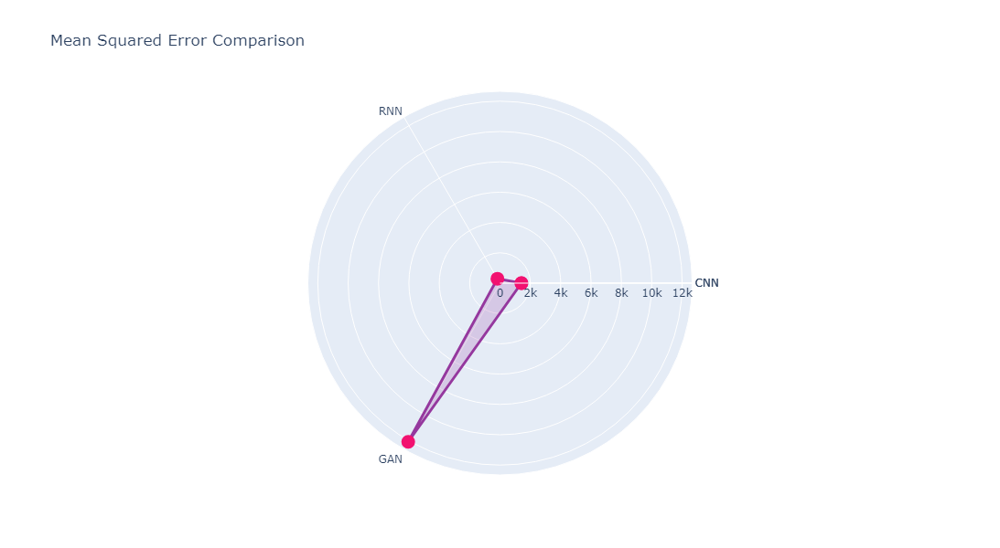

In [654]:
# Converting MSE values to a circular (radar) format
angles = Model_Results['Algo'].tolist()
values = Model_Results['MSE'].tolist()

# Rounding values to 2 decimal places
rounded_values = [round(value, 2) for value in values]

angles += [angles[0]]
values += [values[0]]
rounded_values += [rounded_values[0]]

# Creating a radar plot
fig = go.Figure()

fig.add_trace(go.Scatterpolar(
    r=values,
    theta=angles,
    mode='lines+markers+text',  
    marker=dict(size=15, color='#F21170'),
    line=dict(color='#95389E', width=3),
    fill='toself', 
    fillcolor='rgba(149, 56, 158, 0.2)',  
    # text=rounded_values,  
    # textposition='top left',
    name='MSE Trend'
))

fig.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True
        ),
        angularaxis=dict(
            visible=True,
            tickvals=list(range(len(angles))),  
            ticktext=angles 
        )
    ),
    title='Mean Squared Error Comparison',
    height=600,
    width=600
)

# Showing the plot
fig.show()

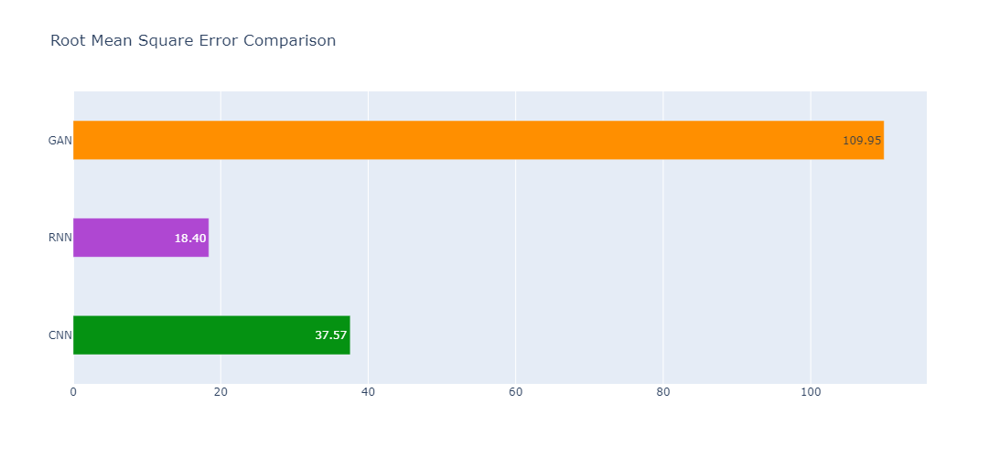

In [658]:
# plotting bar plot to comapre applied models based on Root Mean Squared Error 
fig = go.Figure(data=[go.Bar(
    y=Model_Results['Algo'],
    x=Model_Results['RMSE'],
    marker_color=['#059212','#AF47D2','#FF8F00'],
    width=0.4,
    text=Model_Results['RMSE'],
    textposition='auto',
    orientation='h'
)])

fig.update_layout(
    title_text="Root Mean Square Error Comparison",
    height=500,
    width=1000
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='inside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

fig.show()

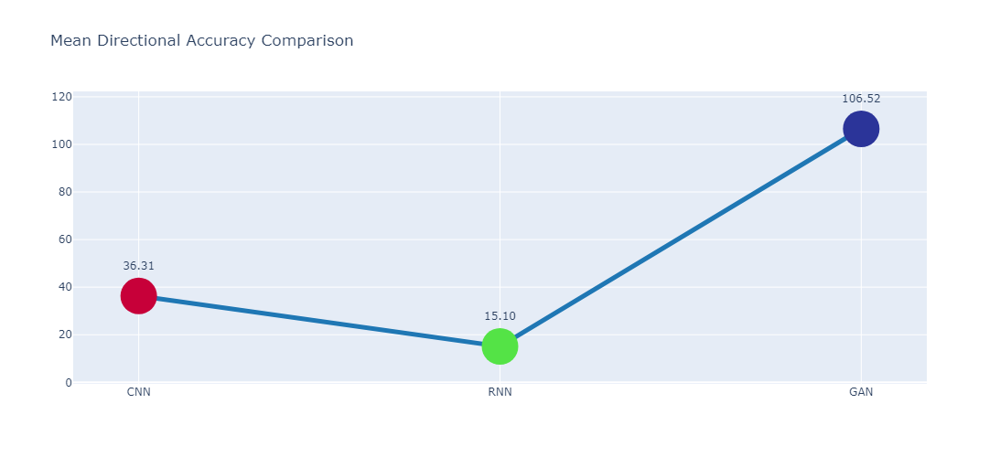

In [496]:
# plotting scatter line plot to comapre applied models based on Mean Directional Accuracy 
fig = go.Figure(data=go.Scatter(
    x=Model_Results['Algo'],
    y=Model_Results['MDE'],
    mode='lines+markers+text',
    marker=dict(
        color=['#C70039','#54E346','#2B3499'],
        size=40
    ),
    line=dict(
        color='#1f77b4',
        width=5
    ),
    text=Model_Results['MDE'],
    textposition='top center'
))

fig.update_layout(
    title_text="Mean Directional Accuracy Comparison",
    height=500,
    width=1000
)

fig.update_traces(texttemplate='%{text:.2f}')

fig.show()
